<a href="https://colab.research.google.com/github/krushitdudhat/project0/blob/master/lab_a2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Lab A2


Music Generation with RNNs 

In [24]:
%tensorflow_version 2.x
import tensorflow as tf

!pip install mitdeeplearning
import mitdeeplearning as mdl

#import all packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1


In [22]:
#download the dataset
songs= mdl.lab1.load_training_data()

#print song to inspact it in detail.
example_song = songs[3]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:4
T:Blackbird
Z: id:dc-hornpipe-4
M:C|
L:1/8
K:D Mixolydian
AG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!
F2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2D2 D2:|!
fg|agfa gfeg|fd e^c d=cA2|agfa gfde|fdgf e2 fg|!
a2ge f3e|d^cde fdAG|AdcA GcAG|F2D2 D2:|!


In [23]:
#cconvert the abc notation to audio file and listen
mdl.lab1.play_song(example_song)

In [25]:
#join our list of song string into a single string containing songs
songs_joined = "\n\n".join(songs)

#find all unique character in the joined string 
vocab = sorted(set(songs_joined))
print("there are ", len(vocab), "unique character in the dataset" )

there are  83 unique character in the dataset


process the data set for learning task

Vectorize the text

In [27]:
##define numerical representation of text

#create a mapping from character to unique index.
char2idx = {u:i for i, u in enumerate(vocab)}

#create a mapping from indices to characters.
idx2char = np.array(vocab)

In [28]:
print('{')
for char,i in zip(char2idx, range(20)):
  print(' {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('......\n')

{
 '\n':   0,
 ' ' :   1,
 '!' :   2,
 '"' :   3,
 '#' :   4,
 "'" :   5,
 '(' :   6,
 ')' :   7,
 ',' :   8,
 '-' :   9,
 '.' :  10,
 '/' :  11,
 '0' :  12,
 '1' :  13,
 '2' :  14,
 '3' :  15,
 '4' :  16,
 '5' :  17,
 '6' :  18,
 '7' :  19,
......



In [29]:
###vectorize the songs string 

def vectorize_string(string):
  vectorized_output = np.array([char2idx[i] for i in string])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [30]:
print ('{} ---- characters mapped to int ----->  {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))


'X:1\nT:Alex' ---- characters mapped to int ----->  [49 22 13  0 45 22 26 67 60 79]


create training examples and targests

In [31]:
## bach defination to create training examples

def get_batch(vectorized_songs, seq_length, batch_size):
  #the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  #randomly choose the starting indices for the examples in the training batch 
  idx = np.random.choice(n-seq_length, batch_size)
  
  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]
  output_batch = [vectorized_songs[i+1:i+1+seq_length] for i in idx]

  #x_batch, y_batch provides the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch

#perform some simple tests to make sure your batch function works perfectly
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args):
   print("======\n[fail] could not pass ")
else:
  print("=====\n[pass] all tests passed")

[PASS] test_batch_func_shapes
[PASS] test_batch_func_types
[PASS] test_batch_func_next_step
=====
[pass] all tests passed


In [32]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length = 5, batch_size = 1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
  print("step {:3d}".format(i))
  print("input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
  print(" expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

step   0
input: 32 ('G')
 expected output: 27 ('B')
step   1
input: 27 ('B')
 expected output: 32 ('G')
step   2
input: 32 ('G')
 expected output: 1 (' ')
step   3
input: 1 (' ')
 expected output: 29 ('D')
step   4
input: 29 ('D')
 expected output: 32 ('G')



## **the recurrent neural network model**

Now we're ready to define and train a RNN model on our ABC music dataset, and then use that trained model to generate a new song. We'll train our RNN using batches of song snippets from our dataset, which we generated in the previous section.



Define the RNN model

In [33]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      return_sequences = True,
      recurrent_initializer = 'glorot_uniform',
      recurrent_activation = 'sigmoid',
      stateful = True,
  )

In [34]:
## Define teh RNN model

def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([

    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape= [batch_size, None]),
   
    LSTM(rnn_units),

    tf.keras.layers.Dense(vocab_size),   
  ])

  return model

#Build a simple model with default hyperparameters. 
model = build_model(len(vocab), embedding_dim= 256, rnn_units=1024, batch_size=32)

Test out the RNN model

In [35]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_3 (Embedding)      (32, None, 256)           21248     
_________________________________________________________________
lstm_3 (LSTM)                (32, None, 1024)          5246976   
_________________________________________________________________
dense_3 (Dense)              (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [36]:
x, y = get_batch(vectorized_songs, seq_length= 100, batch_size= 32)
pred = model(x)
print("Input shape:     ", x.shape, " # (batch_size, sequence_length")
print("Prediction shape:   ", pred.shape, "# (batch_size, sequence_length, vocab_size")

Input shape:      (32, 100)  # (batch_size, sequence_length
Prediction shape:    (32, 100, 83) # (batch_size, sequence_length, vocab_size


Predictions from the untrained model

In [37]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices, axis=-1).numpy()
sampled_indices

array([49, 33, 16, 73, 72, 32, 46, 44, 50, 28, 72, 28, 61, 25,  5, 62, 62,
       12, 35, 32, 41, 33, 80, 80, 64, 37, 12, 34, 15, 66,  7, 39, 34, 69,
       19, 26, 66, 59, 17,  5, 41,  2, 53,  7, 55, 31, 80, 17, 30,  1, 54,
       20, 56, 41, 29, 58, 19, 38, 34,  2, 81,  7, 33, 81, 27, 26, 21, 19,
       61, 30, 22,  0, 54, 50, 18, 25, 32, 62, 64, 57, 79, 26, 74, 55, 82,
       43, 13, 49, 66, 21, 39, 38, 74, 79, 59,  7, 29, 18, 53, 60])

In [38]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next char predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 '|D4:|!\n\nX:8\nT:South Wind\nZ: id:dc-waltz-5\nM:3/4\nL:1/8\nK:G Major\nc2|B3 A G2|B3 c d2|A6|A4 c2|B3 A G2|'

Next char predictions: 
 "XH4rqGUSYCqCf>'gg0JGPHyyiL0I3k)NIn7Akd5'P!])_Fy5E ^8aPDc7MI!z)HzBA97fE:\n^Y6>GgibxAs_|R1Xk9NMsxd)D6]e"


Training the model: loss and training operations

In [39]:
### defining the loss function   

def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print("Prediction shape: " , pred.shape, " # (batch_size, sequence_length, vocab_size")
print("scalar_loss:     " , example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size
scalar_loss:      4.41894


In [58]:
### Hyperparameter setting and optimization 

#optimization parametrs: 
num_training_iterations = 15000    ##Increse this to train longer
batch_size =4  # Experiment between 1 and 64
seq_length = 100    #experiment between 50 and 500
learning_rate = 5e-3  ##Experiment between le-5 and le-1

#model parameters:
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024  ##Experiment between 1 and 2048

#checkpoints location:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

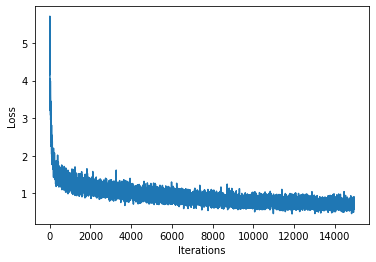

100%|██████████| 15000/15000 [08:21<00:00, 29.89it/s]


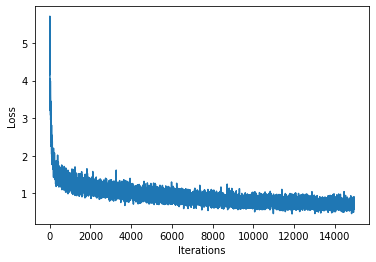

In [59]:
### Define optimizer and training operation 

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)


optimizer = tf.keras.optimizers.Adam(learning_rate)

def train_step(x,y):
  #use tf.gradientTape()
  with tf.GradientTape() as tape:

    y_hat = model(x)

    loss = compute_loss(y , y_hat)

    ## Now, compute the gradients
    grads = tape.gradient(loss, model.trainable_variables)

    ## Apply the gradients to optimizer so it can update the model accordingly
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
    return loss

#########\\
# Begin training !!
#####

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel = 'Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  #Grabe a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  #update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  #update the model with the change weights
  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)

##save the trained model and weights
model.save_weights(checkpoint_prefix)

Generate music using the RNN model

In [60]:
model = build_model( vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1,None]))

model.summary()

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_10 (Embedding)     (1, None, 256)            21248     
_________________________________________________________________
lstm_10 (LSTM)               (1, None, 1024)           5246976   
_________________________________________________________________
dense_10 (Dense)             (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


The prediction procesure

In [61]:
### prediction of generated song

def generate_text(model, start_string , generation_length = 1000):
  #Evaluation step (generating ABC text using the learned RNN model)

  input_eval = [char2idx[i] for i in start_string]
  input_eval = tf.expand_dims(input_eval, 0)

  #empty string to store our results
  text_generated = []

  #Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
    predictions = model(input_eval)

    #remove the batch dimension
    predictions = tf.squeeze(predictions, 0)

    predicted_id = tf.random.categorical( predictions , num_samples = 1)[-1,0].numpy()

    #pass the pradiction along with the previous hidden state
    # as the next inputs to the model
    input_eval = tf.expand_dims([predicted_id], 0)

    text_generated.append(idx2char[predicted_id])

  return (start_string + ''.join(text_generated))

In [62]:
generated_text = generate_text(model, start_string="K", generation_length=1000)


100%|██████████| 1000/1000 [00:05<00:00, 199.71it/s]


Play back the generated music!!

In [63]:
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  #synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  #if its a valid song(correct syntax), play it
  if(waveform):
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 4 songs in text
Generated song 2


Generated song 3
